In [11]:
# read data
dict = {}
with open('data.txt') as f:
    for line in f:
        items = line.split()
        indicator = items[0]
        step = int(items[1])
        val = [float(i) for i in items[2:]]
        if indicator not in dict.keys():
            dict[indicator] = []
        dict[indicator].append((step, val))

In [12]:
dict

{'loss': [(0,
   [0.5927405064951657,
    0.6812204897117219,
    0.3469565639176057,
    0.6792702880579214,
    0.7987634612000918,
    -0.5561642916260031,
    0.5784135127594509,
    1.2388618435521679,
    -0.27337587565497745,
    -0.5326182800615625,
    -0.11757941006500627,
    1.7925494433838485,
    0.47014438810762726,
    0.5699410834499694,
    0.05989506293145097,
    0.5101599704452642,
    0.8244212200528221,
    0.4850165131293977,
    0.8879251389611474,
    -0.4237445602733917,
    -1.5139000856415197,
    0.9689581328637231,
    3.3647455479377797,
    0.9826996509816363,
    -0.31340829929580494,
    0.10557213616831196,
    -0.6048692385126827,
    1.789239437639444,
    0.29355589510327423,
    0.5635509702461773,
    1.6539127532274973,
    1.2268420374788058,
    0.9848505103665754,
    1.4169138839944058,
    0.4864196948109881,
    -0.9733411841566716,
    2.100112323311086,
    -1.1801828234404859,
    -1.4058496239478937,
    0.9875314329406495,
    0.1272

In [20]:
data = dict

import numpy as np

basis_points = [0, 6.68, 15.87, 30.85, 50.00, 69.15, 84.13, 93.32, 100.00]

def get_histogram(data, indicator, step_range, basis_points):
    steps = []
    histograms = []
    for step, val in data[indicator]:
        if step >= step_range[0] and step <= step_range[1]:
            steps.append(step)
            histograms.append(np.percentile(val, basis_points))

    return steps, histograms

In [28]:
steps, histogram = get_histogram(data, 'loss', (0, 10000), basis_points)

In [31]:
histogram = np.array(histogram)
histogram.shape

(10000, 9)

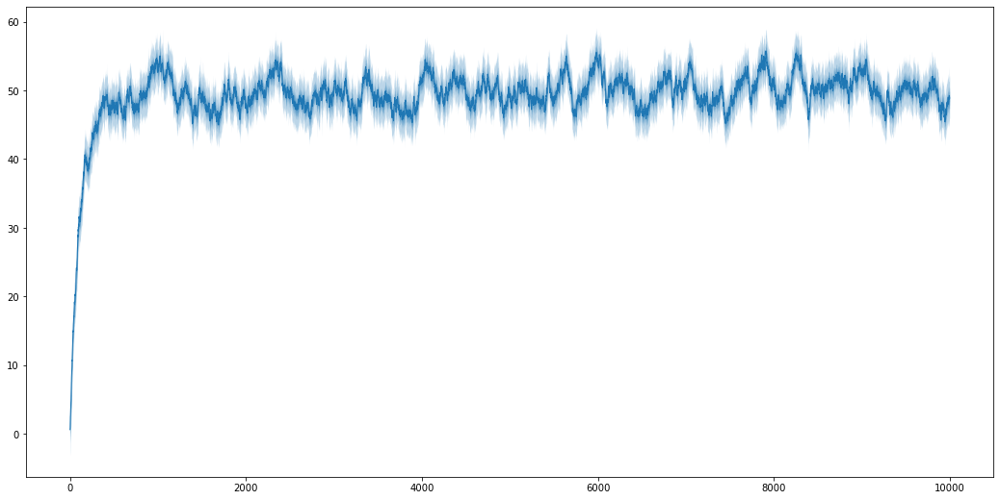

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns

_, ax = plt.subplots(figsize=(18, 9))

ln = ax.plot(steps, histogram[:, 4],
             lw=1,
             color=sns.color_palette()[0],
             alpha=1,
             label="heehee")

for i in range(0, 5):
    ax.fill_between(
        steps,
        histogram[:, 4-i],
        histogram[:, 4+i],
        color=sns.color_palette()[0],
        lw=0,
        alpha=0.3)